In [1]:
# Flow Accumulation and TWI Maps
## Comprehensive visualization of flow routing methods at different DEM resolutions


In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import rasterio
import rasterio.plot
from matplotlib.colors import LogNorm


## Load Background Map


In [ ]:
# ============================================================
# DATA PATHS - Update these paths for your local system
# ============================================================
DATA_BASE_DIR = "./data"  # Relative path from repository root

# Background map file path (optional - can be None if not available)
pkfp = f"{DATA_BASE_DIR}/background/Bk.tif" if os.path.exists(f"{DATA_BASE_DIR}/background/Bk.tif") else None

# Load background map
try:
    if pkfp and os.path.exists(pkfp):
        with rasterio.open(pkfp) as src:
            pk = src.read()
            meta = src.meta.copy()
            meta['transform'] = src.transform
        background_available = True
        print('✅ Background map loaded successfully')
    else:
        background_available = False
        print('⚠️  Background map not found (optional - will skip background)')
except Exception as e:
    background_available = False
    print(f'⚠️  Error loading background map: {e}')


✅ Background map loaded successfully


## Plot 1: Three-Panel Static Rasters
### Flow Accumulation, TWI, and Subsurface Flow Accumulation


✅ Loaded Flow Accumulation
✅ Loaded TWI
✅ Loaded Subsurface Flow Accumulation


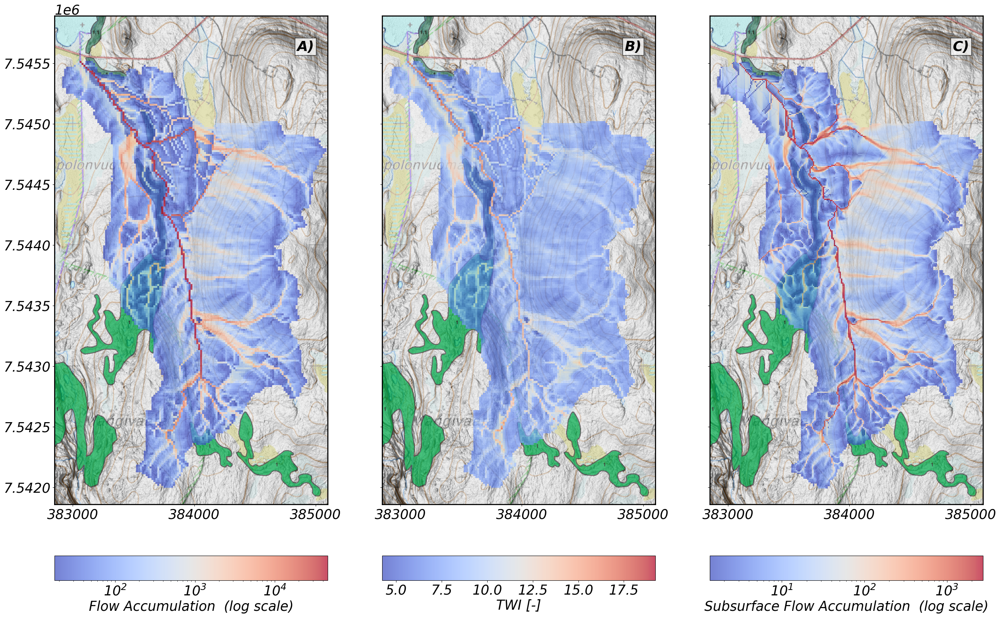

In [ ]:
# File paths for the three static rasters
flowacc_path = f"{DATA_BASE_DIR}/WBT_data/pallas_16/korkeusmalli_16m_culverts_water_no_deps_flowacc_mdinf_clipped.tif"
twi_path = f"{DATA_BASE_DIR}/WBT_data/pallas_16/korkeusmalli_16m_culverts_water_no_deps_twi_mdinf_clipped.tif"
subsurface_flowacc_path = f"{DATA_BASE_DIR}/WBT_data/br_elev_20250715_out/mdinf_cells_clipped.tif"

# Load rasters
file_paths = [
    ('Flow Accumulation', flowacc_path),
    ('TWI', twi_path),
    ('Subsurface Flow Accumulation', subsurface_flowacc_path)
]

rasters = []
for name, path in file_paths:
    if os.path.exists(path):
        with rasterio.open(path) as src:
            data = src.read(1)
            data = np.where(data == src.nodata, np.nan, data) if src.nodata is not None else data
            rasters.append({
                'data': data,
                'transform': src.transform,
                'crs': src.crs,
                'bounds': src.bounds,
            })
        print(f'✅ Loaded {name}')
    else:
        print(f'❌ File not found: {name}')
        raise FileNotFoundError(f'{name} not found')

# Prepare log-scale normalization for flow accumulation (panel A)
flowacc_data = rasters[0]['data'].astype(float)
flowacc_data[flowacc_data <= 0] = np.nan
rasters[0]['data'] = flowacc_data

valid_flowacc = flowacc_data[np.isfinite(flowacc_data)]
if valid_flowacc.size > 0:
    vmin_flowacc = np.percentile(valid_flowacc, 5)
    vmax_flowacc = np.percentile(valid_flowacc, 99)
    if vmin_flowacc <= 0:
        vmin_flowacc = np.min(valid_flowacc[valid_flowacc > 0])
else:
    vmin_flowacc, vmax_flowacc = 1, 10
flowacc_norm = LogNorm(vmin=vmin_flowacc, vmax=vmax_flowacc)

# Prepare log-scale normalization for subsurface flow accumulation (panel C)
subsurface_flowacc_data = rasters[2]['data'].astype(float)
subsurface_flowacc_data[subsurface_flowacc_data <= 0] = np.nan
rasters[2]['data'] = subsurface_flowacc_data

valid_subsurface_flowacc = subsurface_flowacc_data[np.isfinite(subsurface_flowacc_data)]
if valid_subsurface_flowacc.size > 0:
    vmin_subsurface_flowacc = np.percentile(valid_subsurface_flowacc, 5)
    vmax_subsurface_flowacc = np.percentile(valid_subsurface_flowacc, 99)
    if vmin_subsurface_flowacc <= 0:
        vmin_subsurface_flowacc = np.min(valid_subsurface_flowacc[valid_subsurface_flowacc > 0])
else:
    vmin_subsurface_flowacc, vmax_subsurface_flowacc = 1, 10
subsurface_flowacc_norm = LogNorm(vmin=vmin_subsurface_flowacc, vmax=vmax_subsurface_flowacc)

# Panel titles and units
all_variables_static = [
    ('Flow Accumulation', 'A) Flow Accumulation', ''),
    ('TWI', 'B) TWI', '[-]'),
    ('Subsurface Flow Accumulation', 'C) Subsurface Flow Accumulation', ''),
]

# Subplot extent
subplot_extents = [
    [382850, 385100, 7542250, 7545500],
    [382850, 385100, 7542250, 7545500],
    [382850, 385100, 7542250, 7545500],
]

# Create figure
fig = plt.figure(figsize=(31, 19))
gs = fig.add_gridspec(2, 3, height_ratios=[1, 0.05], hspace=0.2, wspace=0.2)
axes = []

for i, (meta_info, (var_short, title, units)) in enumerate(zip(rasters, all_variables_static)):
    ax = fig.add_subplot(gs[0, i])
    axes.append(ax)
    
    plot_data = meta_info['data']
    current_extent = subplot_extents[i]
    
    # Background map
    if background_available:
        rasterio.plot.show(pk, transform=meta['transform'], ax=ax, extent=current_extent)
    
    # Plot data with appropriate normalization
    if i == 0:  # Flow Accumulation - log scale
        im = ax.imshow(
            plot_data, origin='upper', cmap='coolwarm', alpha=0.7,
            extent=(meta_info['bounds'].left, meta_info['bounds'].right,
                    meta_info['bounds'].bottom, meta_info['bounds'].top),
            norm=flowacc_norm, zorder=10,
        )
    elif i == 2:  # Subsurface Flow Accumulation - log scale
        im = ax.imshow(
            plot_data, origin='upper', cmap='coolwarm', alpha=0.7,
            extent=(meta_info['bounds'].left, meta_info['bounds'].right,
                    meta_info['bounds'].bottom, meta_info['bounds'].top),
            norm=subsurface_flowacc_norm, zorder=10,
        )
    else:  # TWI - linear scale
        im = ax.imshow(
            plot_data, origin='upper', cmap='coolwarm', alpha=0.7,
            extent=(meta_info['bounds'].left, meta_info['bounds'].right,
                    meta_info['bounds'].bottom, meta_info['bounds'].top),
            zorder=10,
        )
    
    # Set extent and aspect
    ax.set_xlim(current_extent[0], current_extent[1])
    ax.set_ylim(current_extent[2], current_extent[3])
    ax.margins(0, 0)
    ax.set_aspect('equal', adjustable='datalim')
    ax.set_title('')
    
    # X ticks
    x_range = current_extent[1] - current_extent[0]
    if x_range > 2000:
        x_ticks = np.arange(np.ceil(current_extent[0]/1000)*1000, current_extent[1], 1000)
    else:
        x_ticks = np.arange(np.ceil(current_extent[0]/500)*500, current_extent[1], 500)
    if len(x_ticks) > 0:
        ax.set_xticks(x_ticks)
        ax.set_xticklabels([f"{int(x)}" for x in x_ticks])
    
    # Formatting
    ax.tick_params(axis='both', which='major', labelsize=25)
    ax.xaxis.label.set_fontsize(25)
    ax.xaxis.label.set_style('normal')
    ax.yaxis.label.set_fontsize(25)
    ax.yaxis.label.set_style('normal')
    ax.xaxis.get_offset_text().set_fontsize(25)
    ax.xaxis.get_offset_text().set_style('normal')
    ax.yaxis.get_offset_text().set_fontsize(25)
    ax.yaxis.get_offset_text().set_style('normal')
    
    for label in ax.get_xticklabels():
        label.set_style('normal')
        label.set_fontsize(25)
    for label in ax.get_yticklabels():
        label.set_style('normal')
        label.set_fontsize(25)
    
    for spine in ax.spines.values():
        spine.set_linewidth(2)
    
    # Colorbar
    cbar_ax = fig.add_subplot(gs[1, i])
    cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
    var_label = title.split(') ', 1)[1] if ') ' in title else title
    if i == 0 or i == 2:
        cbar.set_label(f'{var_label} {units} (log scale)', fontsize=25, style='normal')
    else:
        cbar.set_label(f'{var_label} {units}', fontsize=25, style='normal')
    cbar.ax.tick_params(labelsize=25)
    for label in cbar.ax.get_xticklabels():
        label.set_style('normal')
        label.set_fontsize(25)
    
    # Panel letter
    letter_only = title.split(')')[0] + ')'
    ax.text(0.95, 0.95, letter_only, size=26, weight='bold',
            horizontalalignment='right', verticalalignment='top',
            transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0.8))

# Remove y labels from middle and right panels
for i in [1, 2]:
    axes[i].get_yaxis().set_ticklabels([])
    axes[i].set_ylabel('')

plt.show()


## Plot 2: TWI Comparison (8m vs 16m)
### D8, D∞, FD8, MD∞, Rho8


Loaded 10 TWI raster files


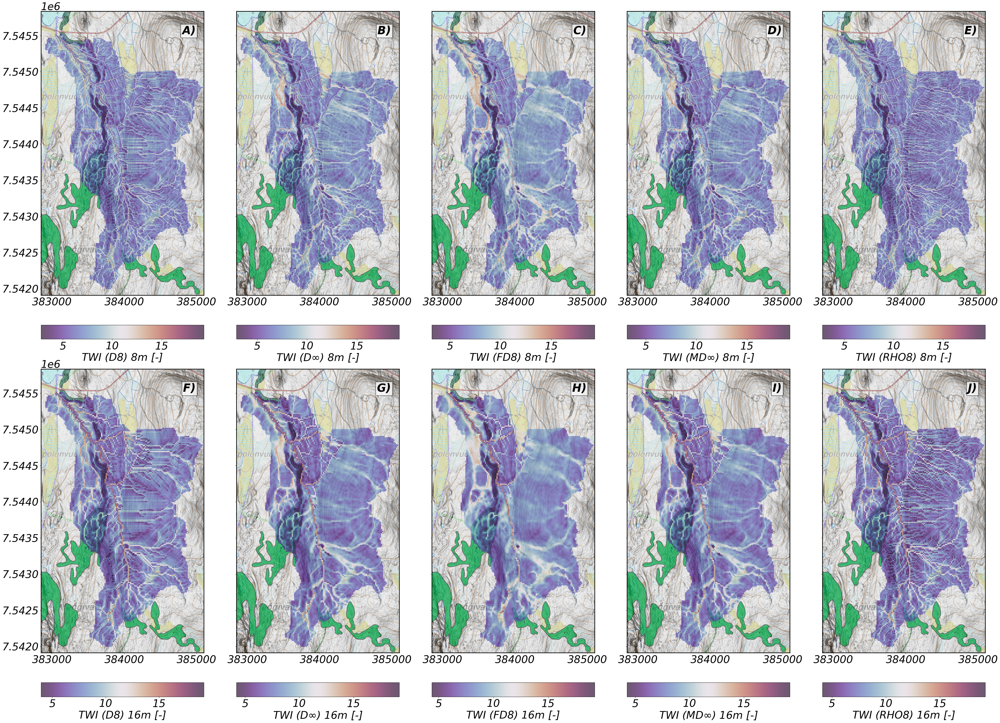

In [ ]:
# Base paths for TWI data
base_path_8m = f"{DATA_BASE_DIR}/WBT_data/pallas_8"
base_path_16m = f"{DATA_BASE_DIR}/WBT_data/pallas_16"

# TWI methods
twi_methods = ['d8', 'dinf', 'fd8', 'mdinf', 'rho8']

# Collect file paths
twi_paths = []
for method in twi_methods:
    path_8m = os.path.join(base_path_8m, f"korkeusmalli_8m_culverts_water_no_deps_twi_{method}_clipped.tif")
    path_16m = os.path.join(base_path_16m, f"korkeusmalli_16m_culverts_water_no_deps_twi_{method}_clipped.tif")
    twi_paths.append((path_8m, path_16m))

# Load rasters
rasters = []
for path_8m, path_16m in twi_paths:
    row_data = []
    for path in [path_8m, path_16m]:
        if os.path.exists(path):
            with rasterio.open(path) as src:
                data = src.read(1)
                data = np.where(data == src.nodata, np.nan, data) if src.nodata is not None else data
                row_data.append({
                    'data': data,
                    'transform': src.transform,
                    'crs': src.crs,
                    'bounds': src.bounds,
                })
        else:
            print(f"Warning: File not found: {path}")
            row_data.append(None)
    rasters.append(row_data)

print(f"Loaded {len([r for row in rasters for r in row if r is not None])} TWI raster files")

# Subplot extent
subplot_extents = [382850, 385100, 7542250, 7545500]

# Create figure
fig = plt.figure(figsize=(52, 38))
gs = fig.add_gridspec(4, 5, height_ratios=[1, 0.05, 1, 0.05], hspace=0.2, wspace=0.2)
axes = []

# Plot each method
for col, (method, row_data) in enumerate(zip(twi_methods, rasters)):
    for row_idx, (plot_row, cbar_row, resolution) in enumerate([(0, 1, '8m'), (2, 3, '16m')]):
        ax = fig.add_subplot(gs[plot_row, col])
        axes.append(ax)
        
        raster_info = row_data[row_idx]
        
        if raster_info is not None:
            plot_data = raster_info['data']
            current_extent = subplot_extents
            
            # Background map
            if background_available:
                rasterio.plot.show(pk, transform=meta['transform'], ax=ax, extent=current_extent)
            
            # Plot TWI data
            im = ax.imshow(
                plot_data, origin='upper', cmap='twilight_shifted', alpha=0.7,
                extent=(raster_info['bounds'].left, raster_info['bounds'].right,
                        raster_info['bounds'].bottom, raster_info['bounds'].top),
                zorder=10,
            )
            
            # Set extent and aspect
            ax.set_xlim(current_extent[0], current_extent[1])
            ax.set_ylim(current_extent[2], current_extent[3])
            ax.margins(0, 0)
            ax.set_aspect('equal', adjustable='datalim')
            ax.set_title('')
            
            # X ticks
            x_range = current_extent[1] - current_extent[0]
            if x_range > 2000:
                x_ticks = np.arange(np.ceil(current_extent[0]/1000)*1000, current_extent[1], 1000)
            else:
                x_ticks = np.arange(np.ceil(current_extent[0]/500)*500, current_extent[1], 500)
            if len(x_ticks) > 0:
                ax.set_xticks(x_ticks)
                ax.set_xticklabels([f"{int(x)}" for x in x_ticks])
            
            # Formatting
            ax.tick_params(axis='both', which='major', labelsize=32)
            ax.xaxis.label.set_fontsize(32)
            ax.xaxis.label.set_style('normal')
            ax.yaxis.label.set_fontsize(32)
            ax.yaxis.label.set_style('normal')
            ax.xaxis.get_offset_text().set_fontsize(32)
            ax.xaxis.get_offset_text().set_style('normal')
            ax.yaxis.get_offset_text().set_fontsize(32)
            ax.yaxis.get_offset_text().set_style('normal')
            
            for label in ax.get_xticklabels():
                label.set_style('normal')
                label.set_fontsize(32)
            for label in ax.get_yticklabels():
                label.set_style('normal')
                label.set_fontsize(32)
            
            for spine in ax.spines.values():
                spine.set_linewidth(2)
            
            # Colorbar
            cbar_ax = fig.add_subplot(gs[cbar_row, col])
            cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
            
            # Method label with infinity symbol
            if method.lower() == 'mdinf':
                method_label = 'MD' + r'$\infty$'
            elif method.lower() == 'dinf':
                method_label = 'D' + r'$\infty$'
            else:
                method_label = method.upper()
            cbar.set_label(f'TWI ({method_label}) {resolution} [-]', fontsize=32, style='normal')
            cbar.ax.tick_params(labelsize=32)
            for label in cbar.ax.get_xticklabels():
                label.set_style('normal')
                label.set_fontsize(32)
            
            # Panel letter
            if row_idx == 0:
                letter = chr(65 + col)  # A-E
            else:
                letter = chr(70 + col)  # F-J
            ax.text(0.95, 0.95, f'{letter})', size=34, weight='bold',
                    horizontalalignment='right', verticalalignment='top',
                    transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0.8))
        else:
            ax.axis('off')

# Remove y labels from columns 1-4
for col in range(1, 5):
    idx_8m = col * 2
    if idx_8m < len(axes):
        axes[idx_8m].get_yaxis().set_ticklabels([])
        axes[idx_8m].set_ylabel('')
    idx_16m = col * 2 + 1
    if idx_16m < len(axes):
        axes[idx_16m].get_yaxis().set_ticklabels([])
        axes[idx_16m].set_ylabel('')

# Remove x labels from top row
for col in range(5):
    idx = col * 2
    if idx < len(axes):
        axes[idx].set_xlabel('')

plt.show()


## Plot 3: Flow Accumulation Comparison (8m vs 16m)
### D8, D∞, FD8, MD∞, Rho8


Loaded 10 Flow Accumulation raster files


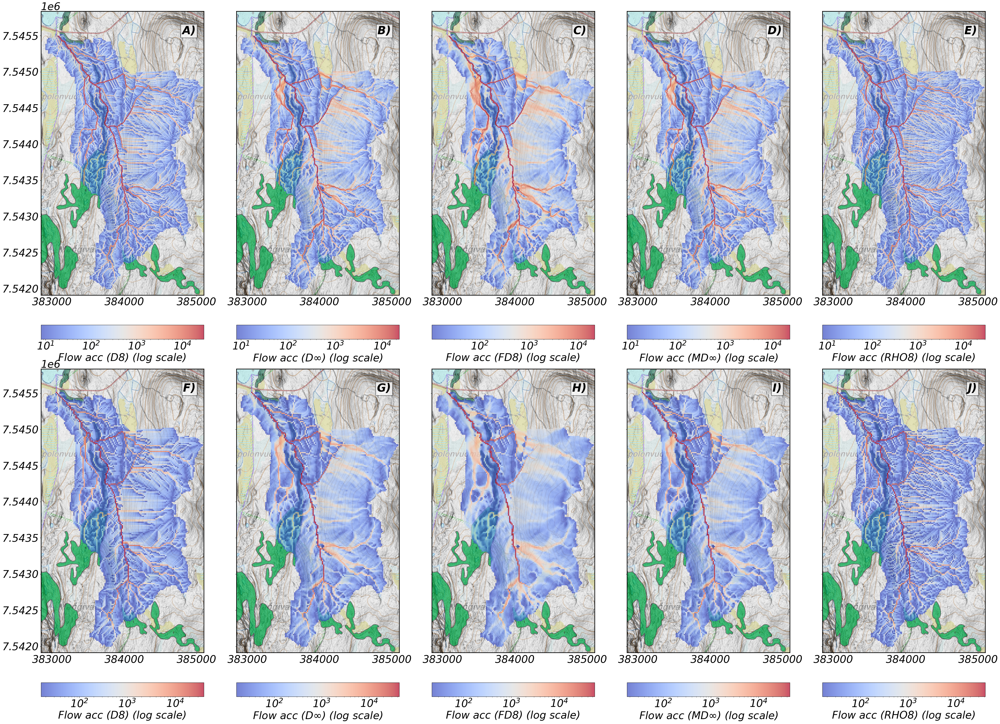

In [ ]:
# Base paths for Flow Accumulation data
base_path_8m = f"{DATA_BASE_DIR}/WBT_data/pallas_8"
base_path_16m = f"{DATA_BASE_DIR}/WBT_data/pallas_16"

# Flow routing methods
flow_methods = ['d8', 'dinf', 'fd8', 'mdinf', 'rho8']

# Collect file paths
flowacc_paths = []
for method in flow_methods:
    path_8m = os.path.join(base_path_8m, f"korkeusmalli_8m_culverts_water_no_deps_flowacc_{method}_clipped.tif")
    path_16m = os.path.join(base_path_16m, f"korkeusmalli_16m_culverts_water_no_deps_flowacc_{method}_clipped.tif")
    flowacc_paths.append((path_8m, path_16m))

# Load rasters
rasters = []
for path_8m, path_16m in flowacc_paths:
    row_data = []
    for path in [path_8m, path_16m]:
        if os.path.exists(path):
            with rasterio.open(path) as src:
                data = src.read(1)
                data = np.where(data == src.nodata, np.nan, data) if src.nodata is not None else data
                data = data.astype(float)
                data[data <= 0] = np.nan
                row_data.append({
                    'data': data,
                    'transform': src.transform,
                    'crs': src.crs,
                    'bounds': src.bounds,
                })
        else:
            print(f"Warning: File not found: {path}")
            row_data.append(None)
    rasters.append(row_data)

print(f"Loaded {len([r for row in rasters for r in row if r is not None])} Flow Accumulation raster files")

# Prepare log-scale normalization
norms = []
for row_data in rasters:
    row_norms = []
    for raster_info in row_data:
        if raster_info is not None:
            plot_data = raster_info['data']
            valid_data = plot_data[np.isfinite(plot_data)]
            if valid_data.size > 0:
                vmin = np.percentile(valid_data, 5)
                vmax = np.percentile(valid_data, 99)
                if vmin <= 0:
                    vmin = np.min(valid_data[valid_data > 0])
                if vmin >= vmax:
                    vmin, vmax = 1, 10
            else:
                vmin, vmax = 1, 10
            row_norms.append(LogNorm(vmin=vmin, vmax=vmax))
        else:
            row_norms.append(None)
    norms.append(row_norms)

# Subplot extent
subplot_extents = [382850, 385100, 7542250, 7545500]

# Create figure
fig = plt.figure(figsize=(52, 38))
gs = fig.add_gridspec(4, 5, height_ratios=[1, 0.05, 1, 0.05], hspace=0.2, wspace=0.2)
axes = []

# Plot each method
for col, (method, row_data, row_norms) in enumerate(zip(flow_methods, rasters, norms)):
    for row_idx, (plot_row, cbar_row, resolution) in enumerate([(0, 1, '8m'), (2, 3, '16m')]):
        ax = fig.add_subplot(gs[plot_row, col])
        axes.append(ax)
        
        raster_info = row_data[row_idx]
        norm = row_norms[row_idx]
        
        if raster_info is not None and norm is not None:
            plot_data = raster_info['data']
            current_extent = subplot_extents
            
            # Background map
            if background_available:
                rasterio.plot.show(pk, transform=meta['transform'], ax=ax, extent=current_extent)
            
            # Plot Flow Accumulation data with log scale
            im = ax.imshow(
                plot_data, origin='upper', cmap='coolwarm', alpha=0.7,
                extent=(raster_info['bounds'].left, raster_info['bounds'].right,
                        raster_info['bounds'].bottom, raster_info['bounds'].top),
                norm=norm, zorder=10,
            )
            
            # Set extent and aspect
            ax.set_xlim(current_extent[0], current_extent[1])
            ax.set_ylim(current_extent[2], current_extent[3])
            ax.margins(0, 0)
            ax.set_aspect('equal', adjustable='datalim')
            ax.set_title('')
            
            # X ticks
            x_range = current_extent[1] - current_extent[0]
            if x_range > 2000:
                x_ticks = np.arange(np.ceil(current_extent[0]/1000)*1000, current_extent[1], 1000)
            else:
                x_ticks = np.arange(np.ceil(current_extent[0]/500)*500, current_extent[1], 500)
            if len(x_ticks) > 0:
                ax.set_xticks(x_ticks)
                ax.set_xticklabels([f"{int(x)}" for x in x_ticks])
            
            # Formatting
            ax.tick_params(axis='both', which='major', labelsize=32)
            ax.xaxis.label.set_fontsize(32)
            ax.xaxis.label.set_style('normal')
            ax.yaxis.label.set_fontsize(32)
            ax.yaxis.label.set_style('normal')
            ax.xaxis.get_offset_text().set_fontsize(32)
            ax.xaxis.get_offset_text().set_style('normal')
            ax.yaxis.get_offset_text().set_fontsize(32)
            ax.yaxis.get_offset_text().set_style('normal')
            
            for label in ax.get_xticklabels():
                label.set_style('normal')
                label.set_fontsize(32)
            for label in ax.get_yticklabels():
                label.set_style('normal')
                label.set_fontsize(32)
            
            for spine in ax.spines.values():
                spine.set_linewidth(2)
            
            # Colorbar
            cbar_ax = fig.add_subplot(gs[cbar_row, col])
            cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
            
            # Method label with infinity symbol
            if method.lower() == 'mdinf':
                method_label = 'MD' + r'$\infty$'
            elif method.lower() == 'dinf':
                method_label = 'D' + r'$\infty$'
            else:
                method_label = method.upper()
            cbar.set_label(f'Flow acc ({method_label}) (log scale)', fontsize=32, style='normal')
            cbar.ax.tick_params(labelsize=32)
            for label in cbar.ax.get_xticklabels():
                label.set_style('normal')
                label.set_fontsize(32)
            
            # Panel letter
            if row_idx == 0:
                letter = chr(65 + col)  # A-E
            else:
                letter = chr(70 + col)  # F-J
            ax.text(0.95, 0.95, f'{letter})', size=34, weight='bold',
                    horizontalalignment='right', verticalalignment='top',
                    transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0.8))
        else:
            ax.axis('off')

# Remove y labels from columns 1-4
for col in range(1, 5):
    idx_8m = col * 2
    if idx_8m < len(axes):
        axes[idx_8m].get_yaxis().set_ticklabels([])
        axes[idx_8m].set_ylabel('')
    idx_16m = col * 2 + 1
    if idx_16m < len(axes):
        axes[idx_16m].get_yaxis().set_ticklabels([])
        axes[idx_16m].set_ylabel('')

# Remove x labels from top row
for col in range(5):
    idx = col * 2
    if idx < len(axes):
        axes[idx].set_xlabel('')

plt.show()


## Plot 4: Subsurface Flow Accumulation Comparison
### D8, D∞, FD8, MD∞, Rho8


Loaded 5 Subsurface Flow Accumulation raster files


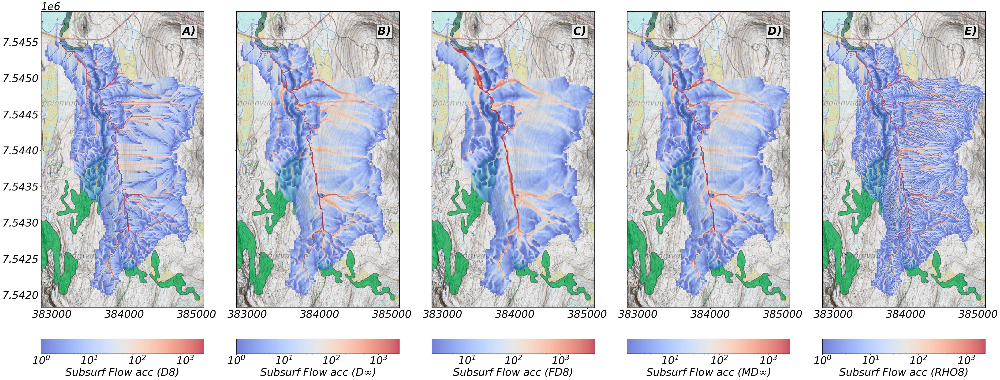

In [ ]:
# Base path for subsurface flow accumulation
base_path_subsurface = f"{DATA_BASE_DIR}/WBT_data/br_elev_20250715_out"

# Flow routing methods
flow_methods = ['d8', 'dinf', 'fd8', 'mdinf', 'rho8']

# Collect file paths
subsurface_flowacc_paths = []
for method in flow_methods:
    path = os.path.join(base_path_subsurface, f"{method}_cells_clipped.tif")
    subsurface_flowacc_paths.append(path)

# Load rasters
rasters = []
for path in subsurface_flowacc_paths:
    if os.path.exists(path):
        with rasterio.open(path) as src:
            data = src.read(1)
            data = np.where(data == src.nodata, np.nan, data) if src.nodata is not None else data
            data = data.astype(float)
            data[data <= 0] = np.nan
            rasters.append({
                'data': data,
                'transform': src.transform,
                'crs': src.crs,
                'bounds': src.bounds,
            })
    else:
        print(f"Warning: File not found: {path}")
        rasters.append(None)

print(f"Loaded {len([r for r in rasters if r is not None])} Subsurface Flow Accumulation raster files")

# Prepare log-scale normalization
norms = []
for raster_info in rasters:
    if raster_info is not None:
        plot_data = raster_info['data']
        valid_data = plot_data[np.isfinite(plot_data)]
        if valid_data.size > 0:
            vmin = np.percentile(valid_data, 5)
            vmax = np.percentile(valid_data, 99)
            if vmin <= 0:
                vmin = np.min(valid_data[valid_data > 0])
            if vmin >= vmax:
                vmin, vmax = 1, 10
        else:
            vmin, vmax = 1, 10
        norms.append(LogNorm(vmin=vmin, vmax=vmax))
    else:
        norms.append(None)

# Subplot extent
subplot_extents = [382850, 385100, 7542250, 7545500]

# Create figure
fig = plt.figure(figsize=(52, 19))
gs = fig.add_gridspec(2, 5, height_ratios=[1, 0.05], hspace=0.2, wspace=0.2)
axes = []

# Plot each method
for col, (method, raster_info, norm) in enumerate(zip(flow_methods, rasters, norms)):
    ax = fig.add_subplot(gs[0, col])
    axes.append(ax)
    
    if raster_info is not None and norm is not None:
        plot_data = raster_info['data']
        current_extent = subplot_extents
        
        # Background map
        if background_available:
            rasterio.plot.show(pk, transform=meta['transform'], ax=ax, extent=current_extent)
        
        # Plot Subsurface Flow Accumulation data with log scale
        im = ax.imshow(
            plot_data, origin='upper', cmap='coolwarm', alpha=0.7,
            extent=(raster_info['bounds'].left, raster_info['bounds'].right,
                    raster_info['bounds'].bottom, raster_info['bounds'].top),
            norm=norm, zorder=10,
        )
        
        # Set extent and aspect
        ax.set_xlim(current_extent[0], current_extent[1])
        ax.set_ylim(current_extent[2], current_extent[3])
        ax.margins(0, 0)
        ax.set_aspect('equal', adjustable='datalim')
        ax.set_title('')
        
        # X ticks
        x_range = current_extent[1] - current_extent[0]
        if x_range > 2000:
            x_ticks = np.arange(np.ceil(current_extent[0]/1000)*1000, current_extent[1], 1000)
        else:
            x_ticks = np.arange(np.ceil(current_extent[0]/500)*500, current_extent[1], 500)
        if len(x_ticks) > 0:
            ax.set_xticks(x_ticks)
            ax.set_xticklabels([f"{int(x)}" for x in x_ticks])
        
        # Formatting
        ax.tick_params(axis='both', which='major', labelsize=32)
        ax.xaxis.label.set_fontsize(32)
        ax.xaxis.label.set_style('normal')
        ax.yaxis.label.set_fontsize(32)
        ax.yaxis.label.set_style('normal')
        ax.xaxis.get_offset_text().set_fontsize(32)
        ax.xaxis.get_offset_text().set_style('normal')
        ax.yaxis.get_offset_text().set_fontsize(32)
        ax.yaxis.get_offset_text().set_style('normal')
        
        for label in ax.get_xticklabels():
            label.set_style('normal')
            label.set_fontsize(32)
        for label in ax.get_yticklabels():
            label.set_style('normal')
            label.set_fontsize(32)
        
        for spine in ax.spines.values():
            spine.set_linewidth(2)
        
        # Colorbar
        cbar_ax = fig.add_subplot(gs[1, col])
        cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
        
        # Method label with infinity symbol
        if method.lower() == 'mdinf':
            method_label = 'MD' + r'$\infty$'
        elif method.lower() == 'dinf':
            method_label = 'D' + r'$\infty$'
        else:
            method_label = method.upper()
        cbar.set_label(f'Subsurf Flow acc ({method_label})', fontsize=32, style='normal')
        cbar.ax.tick_params(labelsize=32)
        for label in cbar.ax.get_xticklabels():
            label.set_style('normal')
            label.set_fontsize(32)
        
        # Panel letter
        letter = chr(65 + col)  # A-E
        ax.text(0.95, 0.95, f'{letter})', size=34, weight='bold',
                horizontalalignment='right', verticalalignment='top',
                transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0.8))
    else:
        ax.axis('off')

# Remove y labels from columns 1-4
for col in range(1, 5):
    if col < len(axes):
        axes[col].get_yaxis().set_ticklabels([])
        axes[col].set_ylabel('')

plt.show()
